In [1]:
import os
import math
import pickle
import numpy as np

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from utils import exponential_moving_average, predict

In [2]:
result_dir = "."
result_file_name = "results.pkl"

In [3]:
with open(os.path.join(result_dir, result_file_name), "rb") as f:
    results = pickle.load(f)
    f.close()

In [4]:
results

{'weights': {'backtracking': {0.0001: {'gd': array([-0.39598065, -1.87833431, -0.17523195, -0.64882411, -0.29036856,
           -0.05937905,  0.71237041]),
    'Accelerated': array([ 0.97705753,  0.29221371,  1.14532074,  0.62608952,  1.08266961,
           -0.63833955,  0.06034762]),
    'BFGS': array([ 0.49170527, -0.63421114,  0.66648874,  0.19799079,  0.59731736,
           -0.29877907,  0.04552987]),
    'DFP': array([ 0.75680258, -0.23393254,  0.92636465,  0.4349294 ,  0.86241467,
           -0.41544756,  0.05625126])},
   0.001: {'gd': array([ 0.22722399, -1.79952256,  0.47306305, -0.16189151,  0.33283608,
            0.01741909,  0.42429774]),
    'Accelerated': array([ 0.96695699,  0.09402326,  1.13265173,  0.6222261 ,  1.07256908,
           -0.51907743,  0.06542225]),
    'BFGS': array([ 0.96946915, -0.1879746 ,  1.13468515,  0.62530438,  1.07508123,
           -0.29704929,  0.06443582]),
    'DFP': array([ 0.96949202, -0.18998237,  1.13470851,  0.62532308,  1.07510411,
    

In [5]:
list(results.keys())

['weights',
 'min_train_cost_weights',
 'min_train_cost',
 'min_val_cost',
 'min_val_cost_weights',
 'train_cost',
 'val_cost',
 'time_epoch',
 'wolf_II',
 'goldstein',
 'delta_weights_norm',
 'delta_train_cost',
 'delta_val_cost',
 'train_gradient_norm',
 'val_gradient_norm',
 'inner_count']

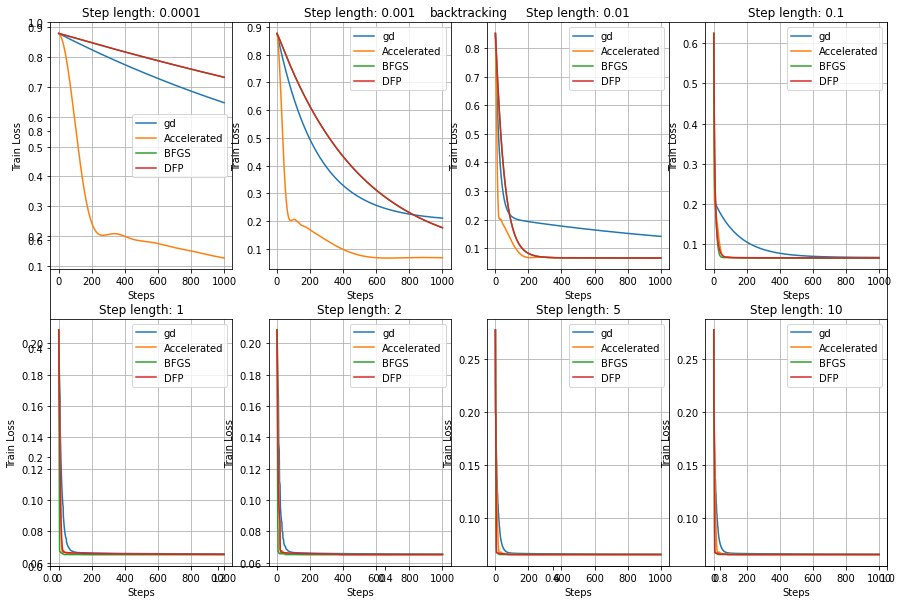

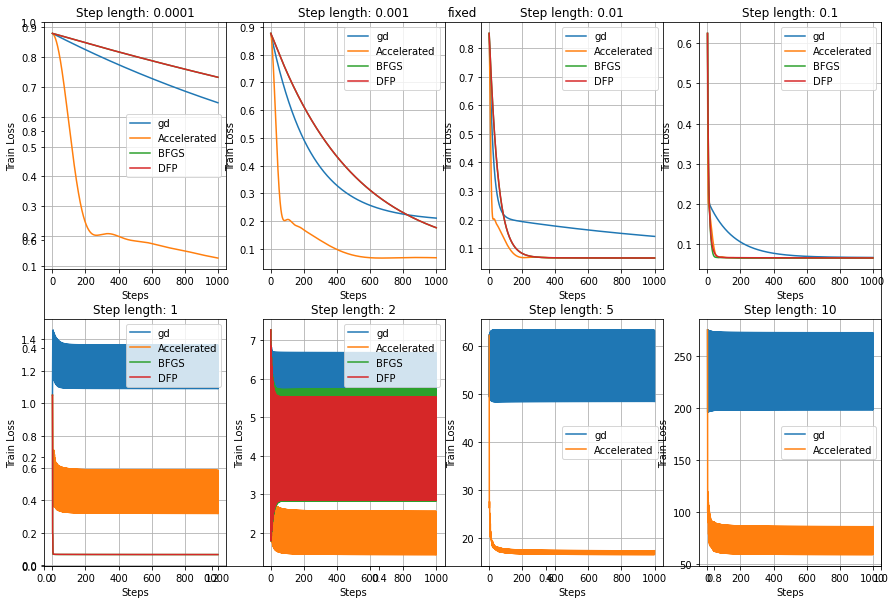

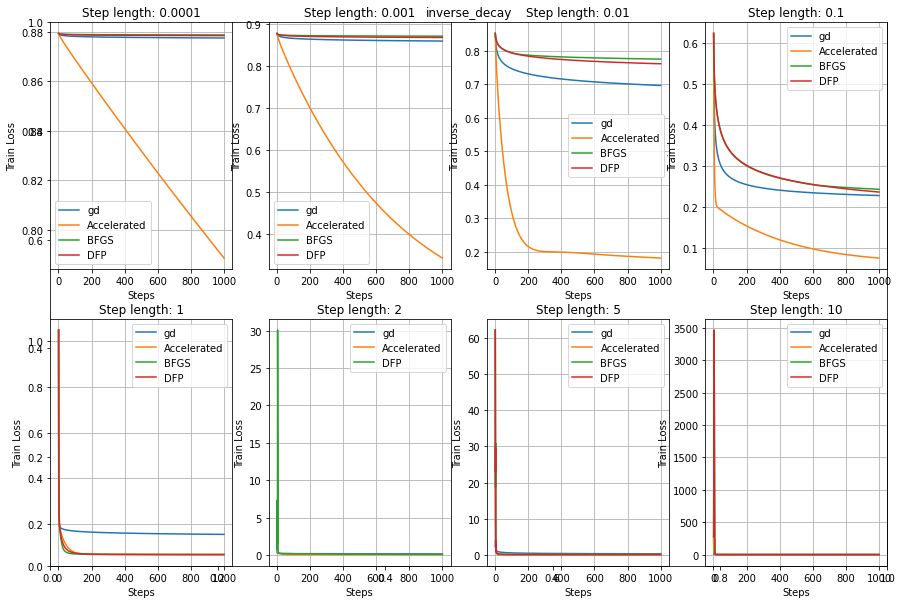

In [6]:
for lr_schedule in results["train_cost"]:
    fig = plt.figure(figsize=(15, 10), facecolor='w')
    plt.title(lr_schedule)
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
    nums = len(results["train_cost"][lr_schedule].keys())
    cols = 4
    rows = math.ceil(nums/cols)
    i = 0
    for step_length in results["train_cost"][lr_schedule]:
        ax = fig.add_subplot(rows, cols, i + 1)
        ax.set_title("Step length: {}".format(step_length))
        x = np.arange(1, 1001)
        for optimizer in results["train_cost"][lr_schedule][step_length]:
            y = results["train_cost"][lr_schedule][step_length][optimizer][:1000]
            if np.isnan(y).any():
                continue
            ax.plot(x, y, label=optimizer)
        ax.set_xlabel("Steps")
        ax.set_ylabel("Train Loss")
        ax.grid()
        ax.legend()
        i += 1
    

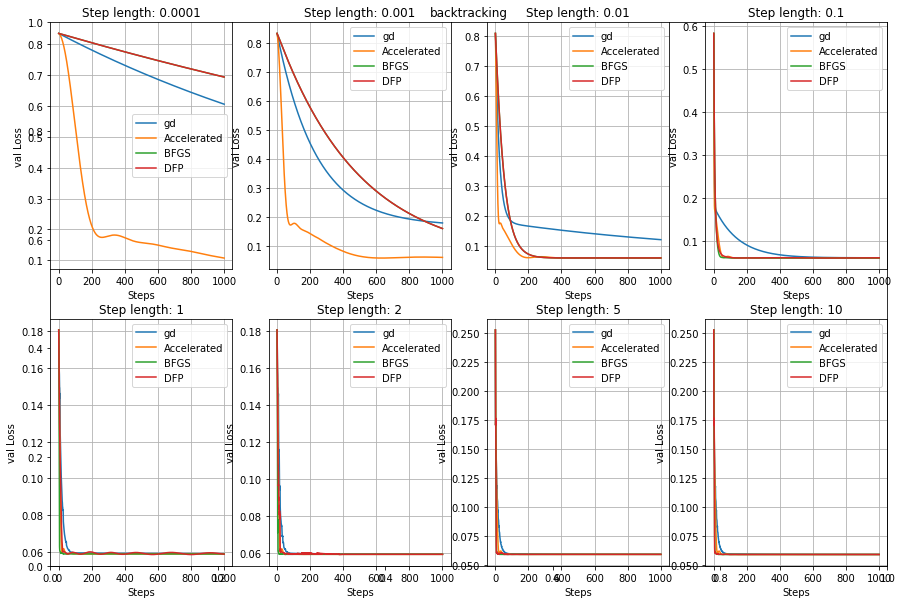

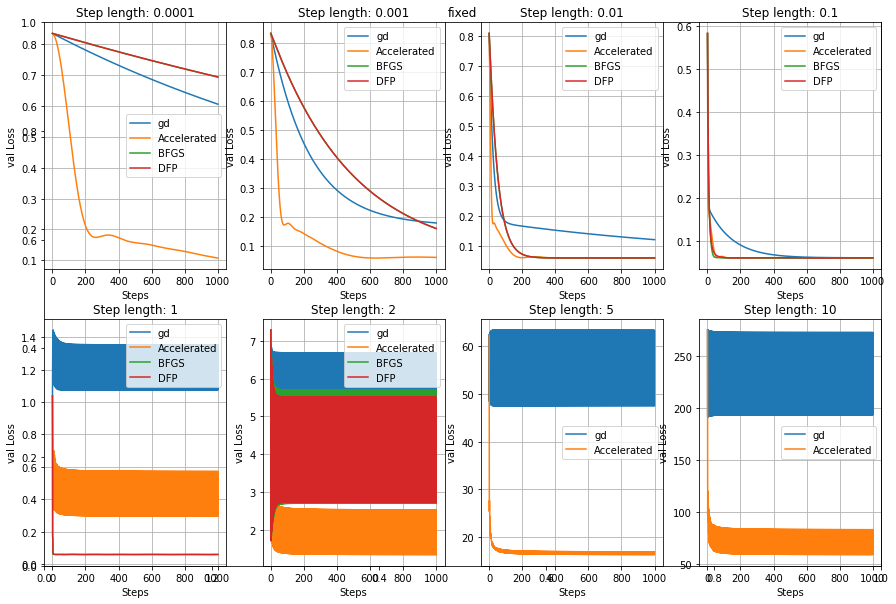

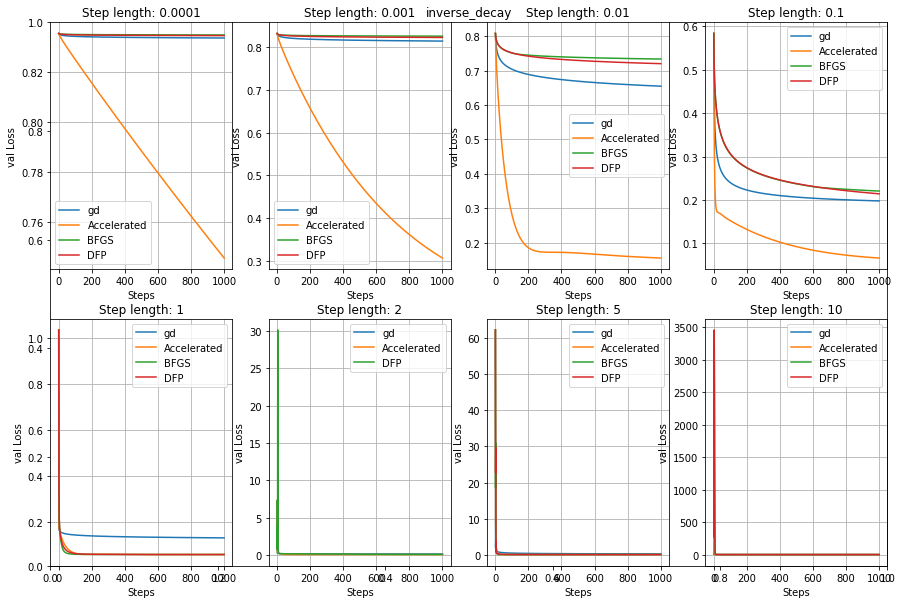

In [7]:
for lr_schedule in results["val_cost"]:
    fig = plt.figure(figsize=(15, 10), facecolor='w')
    plt.title(lr_schedule)
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
    nums = len(results["val_cost"][lr_schedule].keys())
    cols = 4
    rows = math.ceil(nums/cols)
    i = 0
    for step_length in results["val_cost"][lr_schedule]:
        ax = fig.add_subplot(rows, cols, i + 1)
        ax.set_title("Step length: {}".format(step_length))
        x = np.arange(1, 1001)
        for optimizer in results["val_cost"][lr_schedule][step_length]:
            y = results["val_cost"][lr_schedule][step_length][optimizer][:1000]
            if np.isnan(y).any():
                continue
            ax.plot(x, y, label=optimizer)
        ax.set_xlabel("Steps")
        ax.set_ylabel("val Loss")
        ax.grid()
        ax.legend()
        i += 1

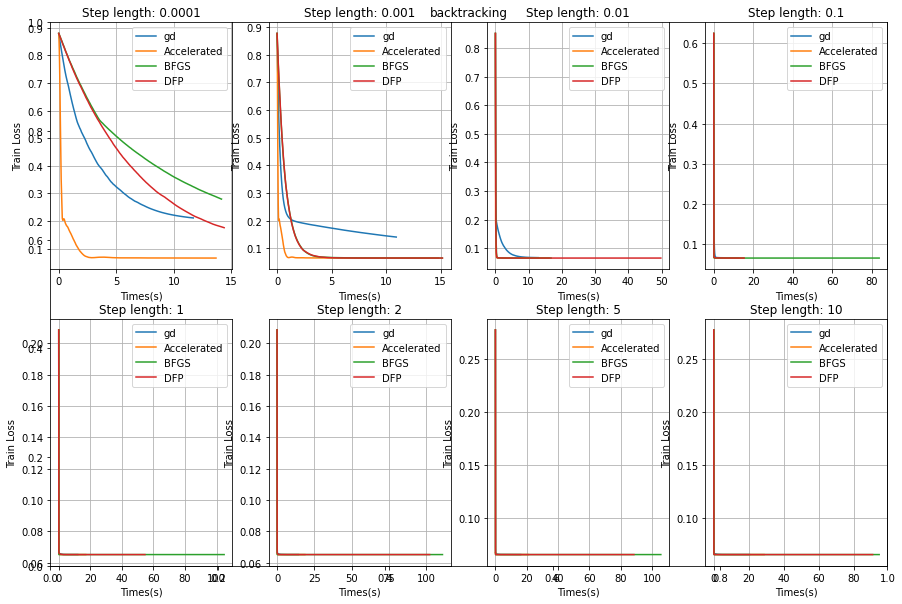

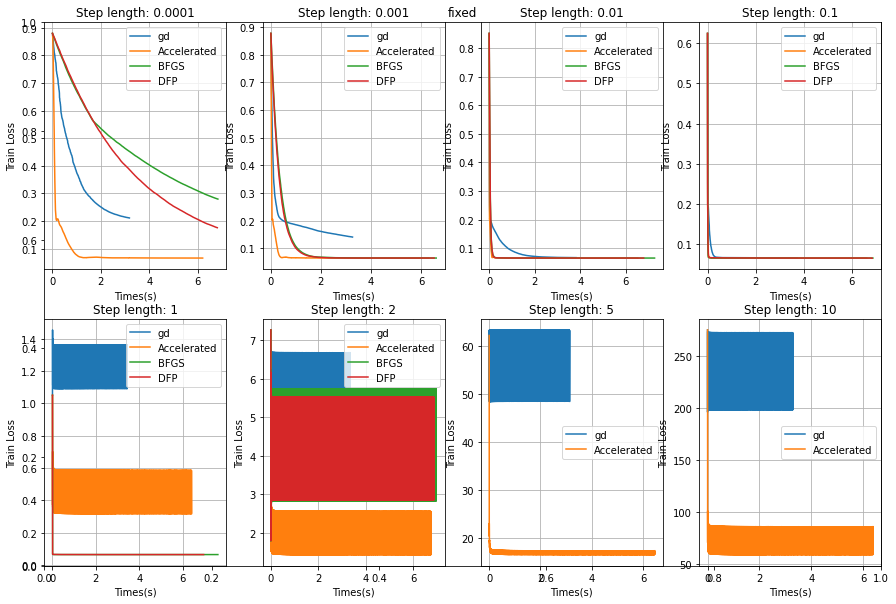

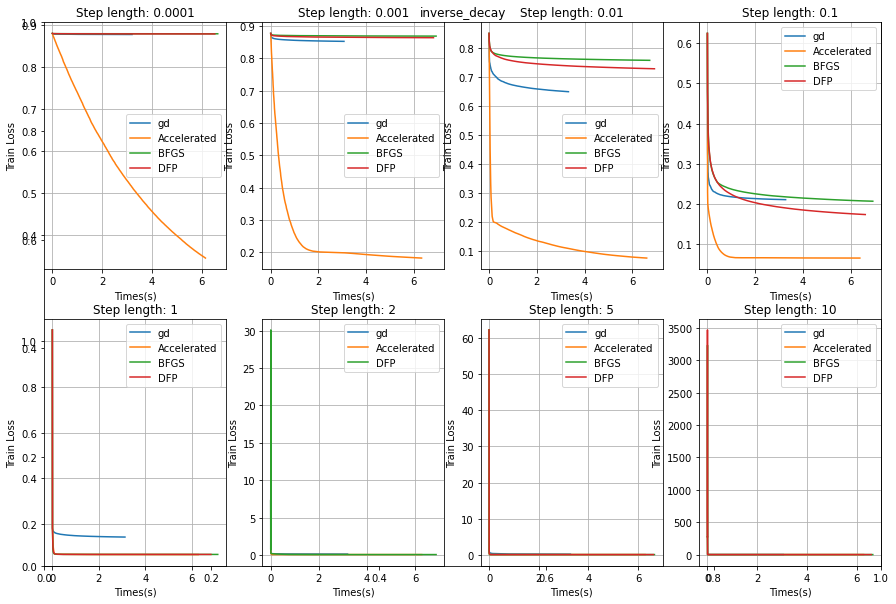

In [8]:
for lr_schedule in results["train_cost"]:
    fig = plt.figure(figsize=(15, 10), facecolor='w')
    plt.title(lr_schedule)
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
    nums = len(results["train_cost"][lr_schedule].keys())
    cols = 4
    rows = math.ceil(nums/cols)
    i = 0
    for step_length in results["train_cost"][lr_schedule]:
        ax = fig.add_subplot(rows, cols, i + 1)
        ax.set_title("Step length: {}".format(step_length))
        for optimizer in results["train_cost"][lr_schedule][step_length]:
            x = np.cumsum(results["time_epoch"][lr_schedule][step_length][optimizer][:10000])
            y = results["train_cost"][lr_schedule][step_length][optimizer][:10000]
            if np.isnan(y).any():
                continue
            ax.plot(x, y, label=optimizer)
        ax.set_xlabel("Times(s)")
        ax.set_ylabel("Train Loss")
        ax.grid()
        ax.legend()
        i += 1

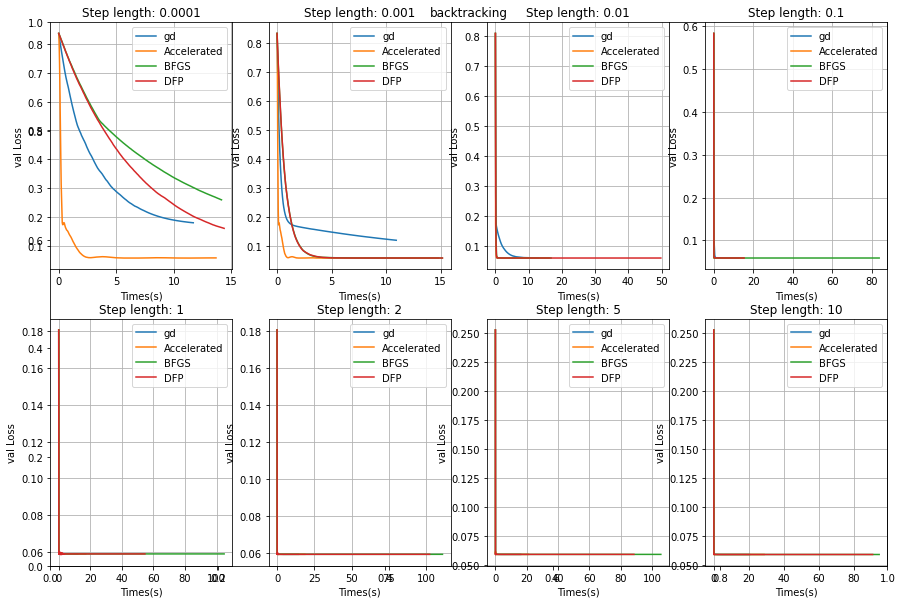

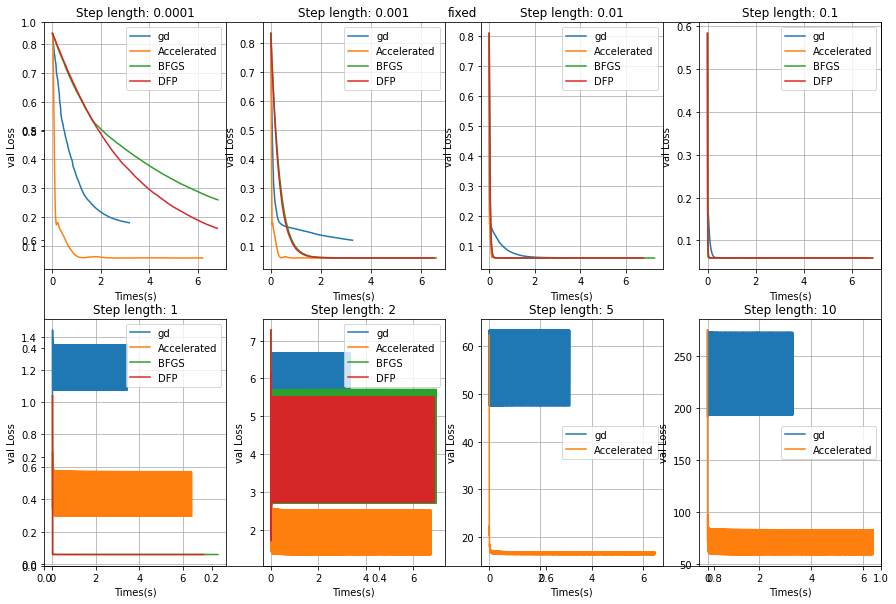

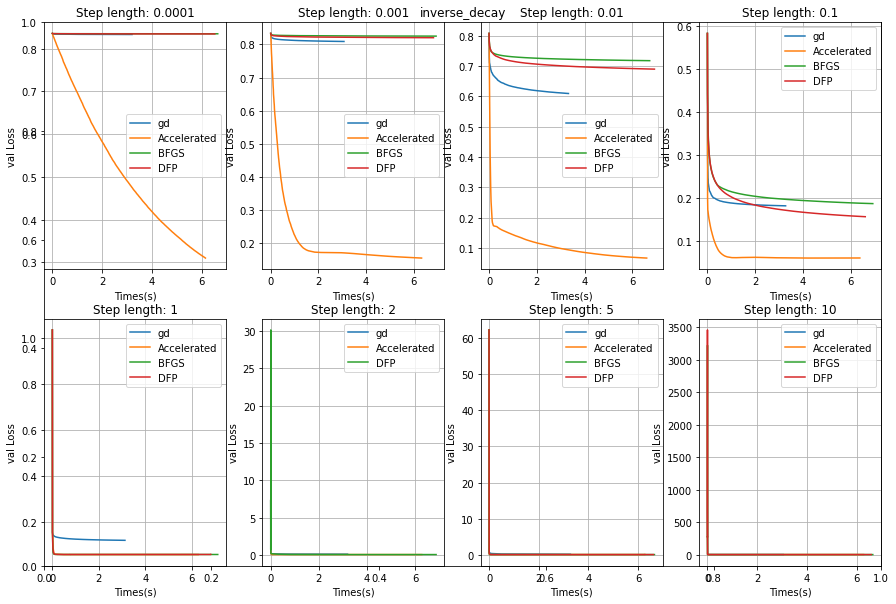

In [9]:
for lr_schedule in results["val_cost"]:
    fig = plt.figure(figsize=(15, 10), facecolor='w')
    plt.title(lr_schedule)
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
    nums = len(results["val_cost"][lr_schedule].keys())
    cols = 4
    rows = math.ceil(nums/cols)
    i = 0
    for step_length in results["val_cost"][lr_schedule]:
        ax = fig.add_subplot(rows, cols, i + 1)
        ax.set_title("Step length: {}".format(step_length))
        for optimizer in results["val_cost"][lr_schedule][step_length]:
            x = np.cumsum(results["time_epoch"][lr_schedule][step_length][optimizer][:10000])
            y = results["val_cost"][lr_schedule][step_length][optimizer][:10000]
            if np.isnan(y).any():
                continue
            ax.plot(x, y, label=optimizer)
        ax.set_xlabel("Times(s)")
        ax.set_ylabel("val Loss")
        ax.grid()
        ax.legend()
        i += 1

In [10]:
np.where(np.asarray(results['train_gradient_norm']["backtracking"][1]["Accelerated"]) <= 1e-3)[0][0]
np.where(np.asarray(results['train_gradient_norm']["backtracking"][1]["Accelerated"]) <= 1e-4)[0][0]
np.argwhere(np.asarray(results['train_gradient_norm']["backtracking"][1]["Accelerated"]) <= 1e-10).shape[0]

0

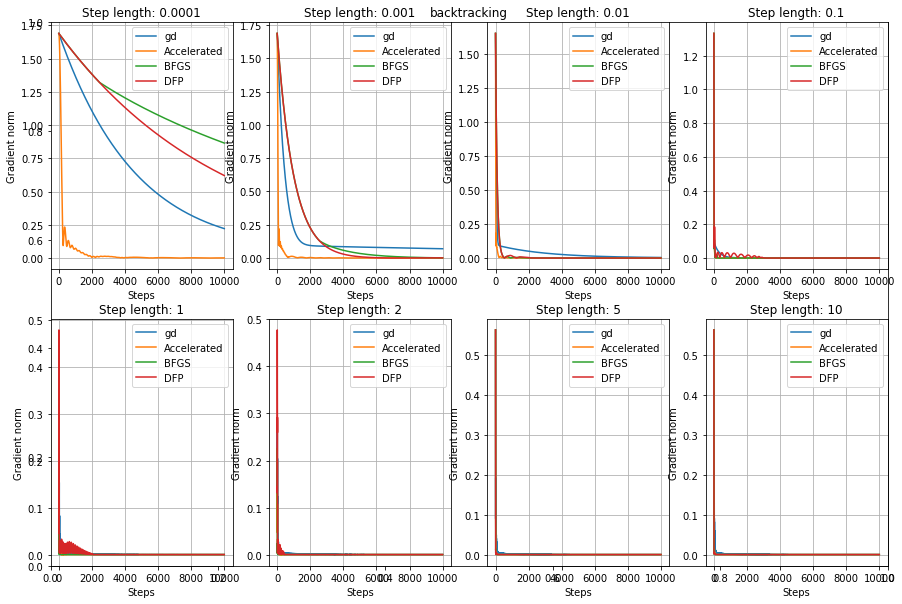

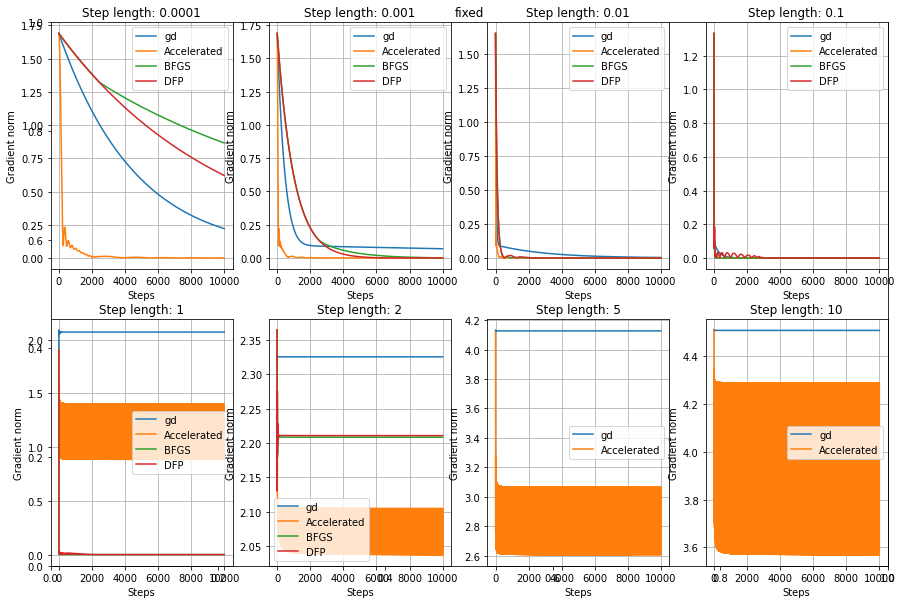

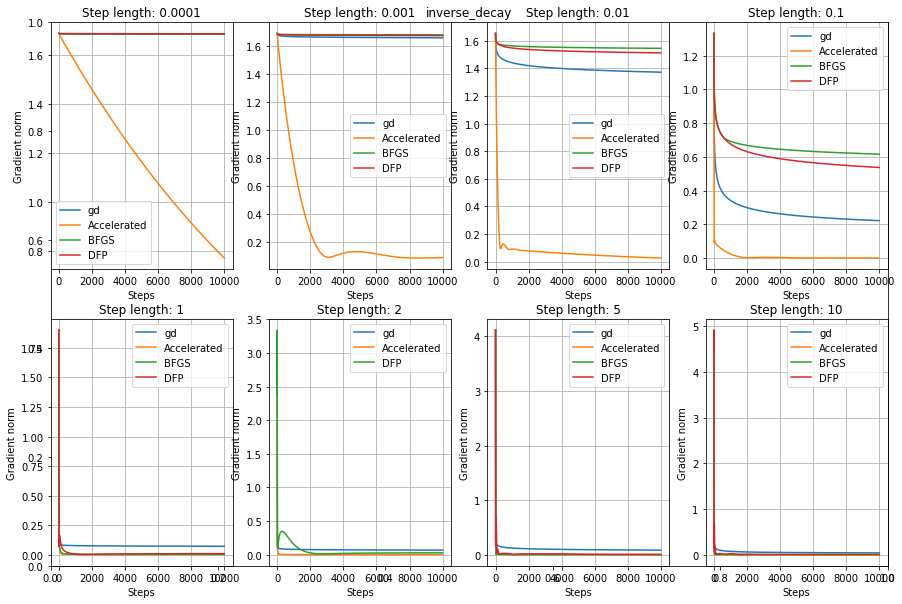

In [11]:
for lr_schedule in results["train_gradient_norm"]:
    fig = plt.figure(figsize=(15, 10), facecolor='w')
    plt.title(lr_schedule)
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
    nums = len(results["train_gradient_norm"][lr_schedule].keys())
    cols = 4
    rows = math.ceil(nums/cols)
    i = 0
    for step_length in results["train_gradient_norm"][lr_schedule]:
        ax = fig.add_subplot(rows, cols, i + 1)
        ax.set_title("Step length: {}".format(step_length))
        x = np.arange(1, 10001)
        for optimizer in results["train_gradient_norm"][lr_schedule][step_length]:
            y = results["train_gradient_norm"][lr_schedule][step_length][optimizer][:10000]
            if np.isnan(y).any():
                continue
            ax.plot(x, y, label=optimizer)
        ax.set_xlabel("Steps")
        ax.set_ylabel("Gradient norm")
        ax.grid()
        ax.legend()
        i += 1

In [14]:
convergence_steps = {}

for lr_schedule in results["train_gradient_norm"]:
    convergence_steps[lr_schedule] = {}
    for step_length in results["train_gradient_norm"][lr_schedule]:
        convergence_steps[lr_schedule][step_length] = {}
        for optimizer in results["train_gradient_norm"][lr_schedule][step_length]:
            step = np.where(np.logical_and(np.asarray(results["train_gradient_norm"][lr_schedule][step_length][optimizer]) <= 1e-4, np.asarray(results["delta_train_cost"][lr_schedule][step_length][optimizer]) <= 1e-3))[0] 
            if step.shape[0] == 0:
                convergence_steps[lr_schedule][step_length][optimizer] = None
            else:
                convergence_steps[lr_schedule][step_length][optimizer] = step[0]

convergence_steps

{'backtracking': {0.0001: {'gd': None,
   'Accelerated': None,
   'BFGS': None,
   'DFP': None},
  0.001: {'gd': None, 'Accelerated': 5571, 'BFGS': None, 'DFP': None},
  0.01: {'gd': None, 'Accelerated': 1758, 'BFGS': 4023, 'DFP': 2850},
  0.1: {'gd': None, 'Accelerated': 552, 'BFGS': 257, 'DFP': 3036},
  1: {'gd': 4649, 'Accelerated': 195, 'BFGS': 33, 'DFP': 2058},
  2: {'gd': 3694, 'Accelerated': 191, 'BFGS': 50, 'DFP': 395},
  5: {'gd': 3867, 'Accelerated': 221, 'BFGS': 26, 'DFP': 78},
  10: {'gd': 3867, 'Accelerated': 221, 'BFGS': 31, 'DFP': 89}},
 'fixed': {0.0001: {'gd': None,
   'Accelerated': None,
   'BFGS': None,
   'DFP': None},
  0.001: {'gd': None, 'Accelerated': 5571, 'BFGS': None, 'DFP': None},
  0.01: {'gd': None, 'Accelerated': 1758, 'BFGS': 4023, 'DFP': 2850},
  0.1: {'gd': None, 'Accelerated': 552, 'BFGS': 257, 'DFP': 3036},
  1: {'gd': None, 'Accelerated': None, 'BFGS': 30, 'DFP': 2035},
  2: {'gd': None, 'Accelerated': None, 'BFGS': None, 'DFP': None},
  5: {'gd': 